In [1]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier #Import Random Forest Model
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from collections import Counter
from sklearn.metrics import classification_report
import seaborn as sns

In [2]:
# let's prep lists to hang on to our result data
list_ratings = ['1.0 Stars', '1.5 Stars', '2.0 Star', '2.5 Stars', '3.0 Stars', '3.5 Stars', '4.0 Stars']
list_measures= ['Rating', 'Model', 'Precision', 'Recall', 'F1-Score', 'Support'] 
list_results = []
list_accuracy = []

In [61]:
list_avgs = []

# Get Data

In [3]:
# load cleaned project data
df= pd.read_csv('resources/data/epicurious_data_cleaned_updated.csv')

# drop columns we don't need
df.drop(['tags', 'date', 'desc', 'directions', 'ingredients', 'rating', 'title'], 
        axis = 1, inplace=True) 

# set the rating_normalized to string for model
df['rating_normalized'] = df['rating_normalized'].astype(str)

# reset index after dropping dta
df.reset_index(drop=True, inplace=True)

# rename the rating_normalized to "label" which is the known classificer
df.rename(columns={'rating_normalized':'label'}, inplace=True)
df.head()

,calories,fat,protein,sodium,ingredients_count,tags_count,age,label
0,403.0,23.0,18.0,1439.0,28,11,12.369863,3.5
1,948.0,79.0,19.0,1042.0,9,10,12.369863,3.5
2,170.0,10.0,7.0,1272.0,10,8,12.369863,3.5
3,602.0,41.0,23.0,1696.0,17,16,8.191781,3.0
4,256.0,5.0,4.0,30.0,7,10,12.369863,3.0


# Create Train/Test Data
We split the data set as 70% training and 30% testing and set the stratify parameter to ensure equal distribution of the classifications.  This train and test data set was used for the next iterations of decision tree and random forest models.

In [4]:
#split dataset in features and target variable
feature_cols = ['calories', 'fat', 'protein', 'sodium', 'ingredients_count', 'tags_count', 'age']

X = df[feature_cols] # Features
y = df.label # Target variable

# Split dataset into training set and test set
# 70% training and 30% test
# random state set to keep same split across computers
# stratify to ensure even split of categories across train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1, stratify=y) 

print(f'Train {Counter(y_train)}')
print(f'Test {Counter(y_test)}')

Train Counter({'3.5': 2915, '3.0': 1731, '4.0': 943, '2.5': 501, '2.0': 166, '1.0': 54, '1.5': 24})
Test Counter({'3.5': 1250, '3.0': 742, '4.0': 404, '2.5': 215, '2.0': 71, '1.0': 23, '1.5': 10})


## Decision Tree
First, we began with a single decision tree.  For this model, we limited the max depth to 4 and predicted scores on the test data.

In [5]:
# Create Decision Tree classifer object
# use max depth of 4 for easy visualization
clf_dt = DecisionTreeClassifier(max_depth=4)

# Train Decision Tree Classifer
clf_dt = clf_dt.fit(X_train,y_train)

#Predict the response for test dataset
y_pred_dt = clf_dt.predict(X_test)

In [6]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred_dt))
print("")
# classification report
print("Decison Tree Classification Report")
print(classification_report(y_pred_dt, y_test))

Accuracy: 0.47661141804788215

Decison Tree Classification Report
              precision    recall  f1-score   support

         1.0       0.00      0.00      0.00         0
         1.5       0.00      0.00      0.00         0
         2.0       0.00      0.00      0.00         0
         2.5       0.00      0.00      0.00         0
         3.0       0.00      0.50      0.01         6
         3.5       0.93      0.48      0.64      2404
         4.0       0.32      0.43      0.37       305

   micro avg       0.48      0.48      0.48      2715
   macro avg       0.18      0.20      0.14      2715
weighted avg       0.86      0.48      0.60      2715



/Users/amy/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
/Users/amy/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)
/Users/amy/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1145: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


In [7]:
# brute force! capture results of near miss and add to list_results
list_dt = [{list_measures[0]: list_ratings[0], list_measures[1]: 'Decision Tree', list_measures[2]: .00, list_measures[3]: .00, list_measures[4]:.00, list_measures[5]: 0}, 
                  {list_measures[0]: list_ratings[1],list_measures[1]: 'Decision Tree', list_measures[2]: .00, list_measures[3]: .00, list_measures[4]:.00, list_measures[5]: 0},
                  {list_measures[0]: list_ratings[2],list_measures[1]: 'Decision Tree', list_measures[2]: .00, list_measures[3]: .00, list_measures[4]:.00, list_measures[5]: 0},
                  {list_measures[0]: list_ratings[3],list_measures[1]: 'Decision Tree', list_measures[2]: .00, list_measures[3]: .00, list_measures[4]:.00, list_measures[5]: 0},
                  {list_measures[0]: list_ratings[4],list_measures[1]: 'Decision Tree', list_measures[2]: .00, list_measures[3]: .50, list_measures[4]:.01, list_measures[5]: 6},
                  {list_measures[0]: list_ratings[5],list_measures[1]: 'Decision Tree', list_measures[2]: .93, list_measures[3]: .48, list_measures[4]:.64, list_measures[5]: 2404},
                  {list_measures[0]: list_ratings[6],list_measures[1]: 'Decision Tree', list_measures[2]: .32, list_measures[3]: .43, list_measures[4]:.37, list_measures[5]: 305}]

list_results.extend(list_dt)

list_accuracy.extend([{'Model':'Decision Tree', 'Accuracy': 0.47661141804788215}])

In [ ]:
list_avgs.extend([{'Model': 'Decision Tree', 'Avg Precision': 0.86, 'Avg Recall': }])

### Decision Tree Results
A single decision tree has an accuracy rate of 48%. The classification report shows we only had predictions for 3.0, 3.5 and 4.0 star recipes.  The decision tree is illustrated in the visualization below.

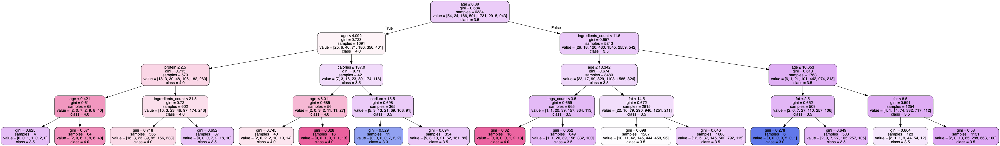

In [8]:
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(clf_dt, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_cols,class_names=clf_dt.classes_)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('decision-tree-viz.png')
Image(graph.create_png())

## Random Forest Model
To increase accuracy, we next used a Random Forest Model. Rather than a single decision tree, our model used 100 trees to predict recipe ratings.  In this model, our average depth of the trees was 33 with 4,185 average number of nodes.

In [9]:
#Create a random forest classifier using 100 trees
clf_rf=RandomForestClassifier(n_estimators=100)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf_rf.fit(X_train,y_train)

#Predict the response for test dataset
y_pred_rf = clf_rf.predict(X_test)

In [10]:
# https://towardsdatascience.com/an-implementation-and-explanation-of-the-random-forest-in-python-77bf308a9b76
n_nodes = []
max_depths = []

# Stats about the trees in random forest
for ind_tree in clf_rf.estimators_:
    n_nodes.append(ind_tree.tree_.node_count)
    max_depths.append(ind_tree.tree_.max_depth)
    
print(f'Average number of nodes {int(np.mean(n_nodes))}')
print(f'Average maximum depth {int(np.mean(max_depths))}')

Average number of nodes 4196
Average maximum depth 32


In [11]:
acc = clf_rf.score(X_test, y_test) # only score on the test
print(f"Accuracy = {acc}")
print("")
# classification report
print("Random Forest Classification Report")
print(classification_report(y_pred_rf, y_test))

Accuracy = 0.5119705340699816

Random Forest Classification Report
              precision    recall  f1-score   support

         1.0       0.17      1.00      0.30         4
         1.5       0.10      0.50      0.17         2
         2.0       0.06      0.67      0.10         6
         2.5       0.12      0.59      0.20        44
         3.0       0.29      0.43      0.34       499
         3.5       0.78      0.53      0.63      1835
         4.0       0.42      0.52      0.47       325

   micro avg       0.51      0.51      0.51      2715
   macro avg       0.28      0.61      0.32      2715
weighted avg       0.63      0.51      0.55      2715



In [12]:
# brute force! capture results of near miss and add to list_results
list_rf = [{list_measures[0]: list_ratings[0], list_measures[1]: 'Random Forest', list_measures[2]: .17, list_measures[3]: 1.00, list_measures[4]:.30, list_measures[5]: 4}, 
                  {list_measures[0]: list_ratings[1],list_measures[1]: 'Random Forest', list_measures[2]: .10, list_measures[3]: .50, list_measures[4]:.17, list_measures[5]: 2},
                  {list_measures[0]: list_ratings[2],list_measures[1]: 'Random Forest', list_measures[2]: .06, list_measures[3]: .67, list_measures[4]:.10, list_measures[5]: 6},
                  {list_measures[0]: list_ratings[3],list_measures[1]: 'Random Forest', list_measures[2]: .12, list_measures[3]: .59, list_measures[4]:.20, list_measures[5]: 44},
                  {list_measures[0]: list_ratings[4],list_measures[1]: 'Random Forest', list_measures[2]: .29, list_measures[3]: .43, list_measures[4]:.34, list_measures[5]: 499},
                  {list_measures[0]: list_ratings[5],list_measures[1]: 'Random Forest', list_measures[2]: .78, list_measures[3]: .53, list_measures[4]:.63, list_measures[5]: 1835},
                  {list_measures[0]: list_ratings[6],list_measures[1]: 'Random Forest', list_measures[2]: .42, list_measures[3]: .52, list_measures[4]:.47, list_measures[5]: 325}]

list_results.extend(list_rf)

list_accuracy.extend([{'Model':'Random Forest', 'Accuracy': 0.5119705340699816}])

In [13]:
# create matrix
# https://stats.stackexchange.com/questions/95209/how-can-i-interpret-sklearn-confusion-matrix
df_precision = pd.crosstab(y_test, y_pred_rf, rownames=['Actual Ratings'], colnames=['Predicted Ratings'], margins=True)
# of recipes predicted correctly
# true predicted / actual true values gives precision

# Plot number of recipes predicted correctly
cm = sns.light_palette("teal", as_cmap=True)

df_precision.style.set_caption('# of Recipes Predicted Correctly')\
    .background_gradient(cmap=cm)

Predicted Ratings,1.0,1.5,2.0,2.5,3.0,3.5,4.0,All
Actual Ratings,,,,,,,,
1.0,4,0,0,0,3,11,5,23
1.5,0,1,0,0,1,7,1,10
2.0,0,0,4,0,10,47,10,71
2.5,0,0,0,26,41,130,18,215
3.0,0,1,1,6,214,476,44,742
3.5,0,0,1,11,190,971,77,1250
4.0,0,0,0,1,40,193,170,404
All,4,2,6,44,499,1835,325,2715


### Results
Accuracy for the Random Forest increased to 51%.  A slight increase - let's review the classification report to see how the data shook out.

Precision is a measure of recipes predicted correctly compared to the total number of actual ratings.  The classification report shows the model has the best precision predicting 3.5 star recipes (78%) with poor to extremely poor precision predicting other star ratings (6%-42%). The matrix shows 971 recipes were predicted 3.5 stars correctly out of a total of 1,250 actual 3.5 star recipes. The worst precision was 2 star recipes with only 4 out of 71 predicted correctly.

Recall is a measure of recipes predicted correctly compared to the total number of all predicted ratings. The classification report shows higher recall for 1, 2 and 2.5 star ratings than the others. Once again referring to the matrix, we see 2 star ratings had 4 recipes predicted correctly out of a total of 6 predictions while the 3.5 star ratings had 977 predicted correctly out of 1,835 predictions.

The F score represents the mean average of both precision and recall in the model.  The support values represent the total number of recipes predicted for each star rating.

The classification report really shows how our imbalanced data affected the accuracy of the model.  Classifications with a higher number of records had better precision scores while those with lower numbers had better recall scores. The best f-score of the bunch was for 3.5 star ratings (63%) which is fairly poor. Revisions to the model will address the imbalance of data.

### Feature Importance
Let's quantify the usefullness of the features provided by reviewing their relative importance in predicting values. This model found sodium and calories to be the most important features when predicting star ratings however the measures are similar across all features.

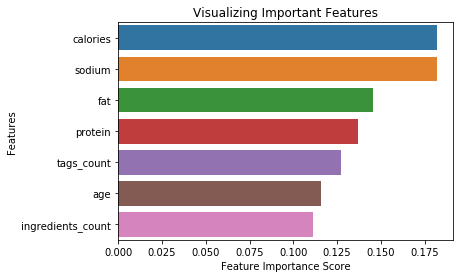

In [14]:
# review feature importance
feature_imp = pd.Series(clf_rf.feature_importances_,index=feature_cols).sort_values(ascending=False)
# feature_imp

# visualize feature importance
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
# Creating a bar plot
sns.barplot(x=feature_imp, y=feature_imp.index)
# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features")
# plt.legend()
plt.show()

### A single tree from the forest
Given our large number of nodes and depth, it's difficult to plot a visualization of a single tree from the forest.

In [15]:
# plot a single decision tree4

from sklearn.externals.six import StringIO  
from IPython.display import Image 
# Import tools needed for visualization
from sklearn.tree import export_graphviz
# import pydot
# Pull out one tree from the forest
tree = clf_rf.estimators_[5]
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydotplus
# Pull out one tree from the forest
tree = clf_rf.estimators_[5]

dot_data = StringIO()
export_graphviz(tree, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_cols)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('random-forest-tree-viz.png')
Image(graph.create_png())


# Improve Model
The dataset is quite imbalanced so in an effort to improve our model, we will apply an oversampling and undersampling technique and compare results to see how they affected the model.

In [19]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import NearMiss
from imblearn.metrics import classification_report_imbalanced

## SMOTE - (Synthetic Minority Over-sampling Technique)
SMOTE is an oversampling technique that creates synthetic samples of miniority classes. In our data, we have far more 3.5 star rated recipes others with very few 1.5 and 1 star ratings.  We'll use SMOTE to bring the number of recipes for all classifictions up to the number of recipes with 3.5 stars which is 2,915.

In [20]:
# check training data counts before applying SMOTE & Near Miss
print(f'Train before SMOTE {Counter(y_train)}')

# fit for SMOTE
smt = SMOTE(random_state=42)
X_train_smt, y_train_smt = smt.fit_sample(X_train, y_train)

# see how SMOTE changed the count of our training set
print(f'Train after SMOTE {Counter(y_train_smt)}')

#Create a new random forest  using 100 trees
clf_smt = RandomForestClassifier(n_estimators=100, random_state=42)

#Train the model using the training sets produced after applying SMOTE
clf_smt.fit(X_train_smt,y_train_smt)

# test data on the model/predict values using same test data
y_pred_smt=clf_smt.predict(X_test)

Train before SMOTE Counter({'3.5': 2915, '3.0': 1731, '4.0': 943, '2.5': 501, '2.0': 166, '1.0': 54, '1.5': 24})
Train after SMOTE Counter({'2.5': 2915, '3.5': 2915, '4.0': 2915, '3.0': 2915, '2.0': 2915, '1.0': 2915, '1.5': 2915})


In [21]:
# Model Accuracy, how often is the classifier correct?
print("SMOTE Accuracy:",metrics.accuracy_score(y_test, y_pred_smt))
print('')
# review classification report from imbalanced classifier
print("SMOTE Classification Report")
print(classification_report_imbalanced(y_test, y_pred_smt))

SMOTE Accuracy: 0.4287292817679558

SMOTE Classification Report
                   pre       rec       spe        f1       geo       iba       sup

        1.0       0.08      0.17      0.98      0.11      0.41      0.16        23
        1.5       0.05      0.10      0.99      0.06      0.31      0.09        10
        2.0       0.09      0.13      0.97      0.10      0.35      0.11        71
        2.5       0.19      0.18      0.94      0.18      0.41      0.15       215
        3.0       0.40      0.35      0.80      0.38      0.53      0.27       742
        3.5       0.56      0.51      0.65      0.53      0.58      0.33      1250
        4.0       0.39      0.51      0.86      0.44      0.67      0.43       404

avg / total       0.44      0.43      0.76      0.43      0.56      0.31      2715



In [22]:
# brute force! capture results of near miss and add to list_results
list_smt = [{list_measures[0]: list_ratings[0], list_measures[1]: 'SMOTE', list_measures[2]: .08, list_measures[3]: .17, list_measures[4]:.11, list_measures[5]: 23}, 
                  {list_measures[0]: list_ratings[1],list_measures[1]: 'SMOTE', list_measures[2]: .05, list_measures[3]: .10, list_measures[4]:.06, list_measures[5]: 10},
                  {list_measures[0]: list_ratings[2],list_measures[1]: 'SMOTE', list_measures[2]: .09, list_measures[3]: .13, list_measures[4]:.10, list_measures[5]: 71},
                  {list_measures[0]: list_ratings[3],list_measures[1]: 'SMOTE', list_measures[2]: .19, list_measures[3]: .18, list_measures[4]:.18, list_measures[5]: 215},
                  {list_measures[0]: list_ratings[4],list_measures[1]: 'SMOTE', list_measures[2]: .40, list_measures[3]: .35, list_measures[4]:.38, list_measures[5]: 742},
                  {list_measures[0]: list_ratings[5],list_measures[1]: 'SMOTE', list_measures[2]: .56, list_measures[3]: .51, list_measures[4]:.53, list_measures[5]: 1250},
                  {list_measures[0]: list_ratings[6],list_measures[1]: 'SMOTE', list_measures[2]: .39, list_measures[3]: .51, list_measures[4]:.44, list_measures[5]: 404}]

list_results.extend(list_smt)

list_accuracy.extend([{'Model':'SMOTE', 'Accuracy': 0.4287292817679558}])


### SMOTE Results in English
After applying SMOTE to upsample our data, we find the accuracy was reduced to 43%. 1 and 1.5 star ratings had the largest improvement of F1 scores

## Near Miss 
NearMiss is an undersampling technique that will make the majority class equal to the minority class. In our data, it will reduce the number of star recipes to be closer to the 1, 1.5 and 2 star ratings (24 records)

In [23]:
# fit for near miss
nm = NearMiss(random_state=42)
X_train_nm, y_train_nm = nm.fit_sample(X_train, y_train)

# see how near miss changed the count of our training set
print(f'Train after Near Miss {Counter(y_train_nm)}')

#Create a new random forest  using 100 trees
clf_nm = RandomForestClassifier(n_estimators=100, random_state=42)

#Train the model using the training sets produced after applying SMOTE
clf_nm.fit(X_train_nm,y_train_nm)

# test data on the model/predict values using same test data
y_pred_nm=clf_nm.predict(X_test)

Train after Near Miss Counter({'1.0': 24, '1.5': 24, '2.0': 24, '2.5': 24, '3.0': 24, '3.5': 24, '4.0': 24})


In [24]:
# Model Accuracy, how often is the classifier correct?
print("Near Miss Accuracy:",metrics.accuracy_score(y_test, y_pred_nm))
print('')
# review classification report from imbalanced classifier
print("Near Miss Classification Report")
print(classification_report_imbalanced(y_test, y_pred_nm))

Near Miss Accuracy: 0.028729281767955802

Near Miss Classification Report
                   pre       rec       spe        f1       geo       iba       sup

        1.0       0.01      0.52      0.68      0.03      0.60      0.35        23
        1.5       0.00      0.70      0.43      0.01      0.55      0.31        10
        2.0       0.05      0.07      0.96      0.06      0.26      0.06        71
        2.5       0.12      0.06      0.96      0.08      0.23      0.05       215
        3.0       0.40      0.01      1.00      0.02      0.09      0.01       742
        3.5       0.39      0.01      0.99      0.02      0.09      0.01      1250
        4.0       0.51      0.06      0.99      0.11      0.25      0.06       404

avg / total       0.38      0.03      0.98      0.04      0.14      0.02      2715



In [25]:
# brute force! capture results of near miss and add to list_results
list_near_miss = [{list_measures[0]: list_ratings[0], list_measures[1]: 'Near Miss', list_measures[2]: .01, list_measures[3]: .52, list_measures[4]:.03, list_measures[5]: 23}, 
                  {list_measures[0]: list_ratings[1],list_measures[1]: 'Near Miss', list_measures[2]: .00, list_measures[3]: .70, list_measures[4]:.01, list_measures[5]: 10},
                  {list_measures[0]: list_ratings[2],list_measures[1]: 'Near Miss', list_measures[2]: .05, list_measures[3]: .07, list_measures[4]:.06, list_measures[5]: 71},
                  {list_measures[0]: list_ratings[3],list_measures[1]: 'Near Miss', list_measures[2]: .12, list_measures[3]: .06, list_measures[4]:.08, list_measures[5]: 215},
                  {list_measures[0]: list_ratings[4],list_measures[1]: 'Near Miss', list_measures[2]: .40, list_measures[3]: .01, list_measures[4]:.02, list_measures[5]: 742},
                  {list_measures[0]: list_ratings[5],list_measures[1]: 'Near Miss', list_measures[2]: .39, list_measures[3]: .01, list_measures[4]:.02, list_measures[5]: 1250},
                  {list_measures[0]: list_ratings[6],list_measures[1]: 'Near Miss', list_measures[2]: .51, list_measures[3]: .06, list_measures[4]:.11, list_measures[5]: 404}]

list_results.extend(list_near_miss)

list_accuracy.extend([{'Model': 'Near Miss', 'Accuracy': 0.028729281767955802}])

### Near Miss Results
The near miss model drastically dropped our accuracy to 3%.

## Comparing Model Results

In [28]:
df_results = pd.DataFrame(list_results, columns =list_measures) 

In [32]:
df_results.head()

,Rating,Model,Precision,Recall,F1-Score,Support
0,1.0 Stars,Decision Tree,0.0,0.0,0.00,0
1,1.5 Stars,Decision Tree,0.0,0.0,0.00,0
2,2.0 Star,Decision Tree,0.0,0.0,0.00,0
3,2.5 Stars,Decision Tree,0.0,0.0,0.00,0
4,3.0 Stars,Decision Tree,0.0,0.5,0.01,6


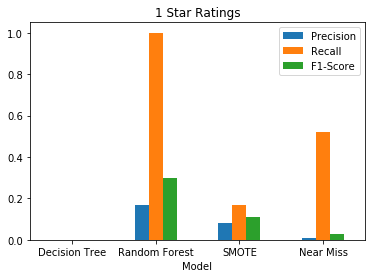

In [42]:
# create 1 star comparison chart
cond = df_results['Rating'] == '1.0 Stars'
df_one_star = df_results[cond]

# drop columns we don't need
df_one_star.drop(['Rating', 'Support'], axis=1, inplace=True)

df_one_star.set_index('Model', inplace=True)


ax = df_one_star.plot.bar(rot=0, title ='1 Star Ratings')

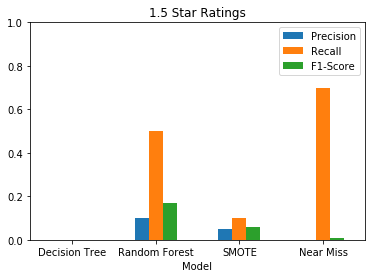

In [55]:
# create 1.5 star comparison chart
cond = df_results['Rating'] == '1.5 Stars'
df_star = df_results[cond]

# drop columns we don't need
df_star.drop(['Rating', 'Support'], axis=1, inplace=True)

df_star.set_index('Model', inplace=True)


ax = df_star.plot.bar(rot=0, ylim=(0.0,1.0), title ='1.5 Star Ratings')

In [49]:
df_results['Rating'].value_counts()

4.0 Stars    4
3.5 Stars    4
1.5 Stars    4
2.5 Stars    4
3.0 Stars    4
2.0 Star     4
1.0 Stars    4
Name: Rating, dtype: int64

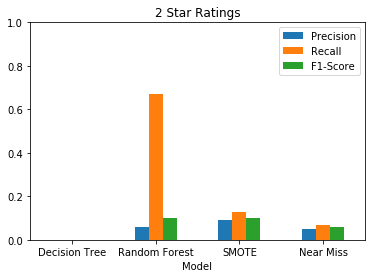

In [56]:
# create 2 star comparison chart
cond = df_results['Rating'] == '2.0 Star'
df_star = df_results[cond]

# drop columns we don't need
df_star.drop(['Rating', 'Support'], axis=1, inplace=True)

df_star.set_index('Model', inplace=True)


ax = df_star.plot.bar(rot=0, ylim=(0.0,1.0), title ='2 Star Ratings')

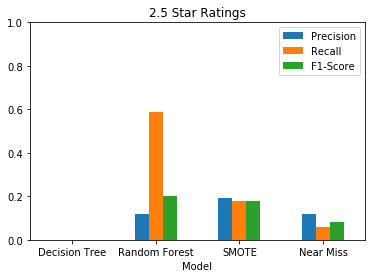

In [57]:
# create 2.5 star comparison chart
cond = df_results['Rating'] == '2.5 Stars'
df_star = df_results[cond]

# drop columns we don't need
df_star.drop(['Rating', 'Support'], axis=1, inplace=True)

df_star.set_index('Model', inplace=True)


ax = df_star.plot.bar(rot=0, ylim=(0.0,1.0), title ='2.5 Star Ratings')

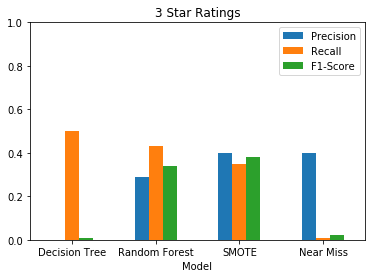

In [58]:
# create 3 star comparison chart
cond = df_results['Rating'] == '3.0 Stars'
df_star = df_results[cond]

# drop columns we don't need
df_star.drop(['Rating', 'Support'], axis=1, inplace=True)

df_star.set_index('Model', inplace=True)


ax = df_star.plot.bar(rot=0, ylim=(0.0,1.0), title ='3 Star Ratings')

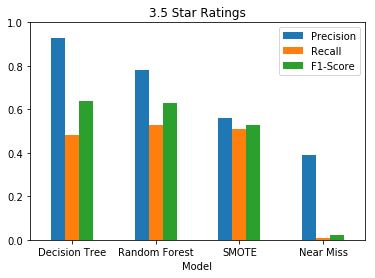

In [59]:
# create 3.5 star comparison chart
cond = df_results['Rating'] == '3.5 Stars'
df_star = df_results[cond]

# drop columns we don't need
df_star.drop(['Rating', 'Support'], axis=1, inplace=True)

df_star.set_index('Model', inplace=True)


ax = df_star.plot.bar(rot=0,ylim=(0.0,1.0), title ='3.5 Star Ratings')

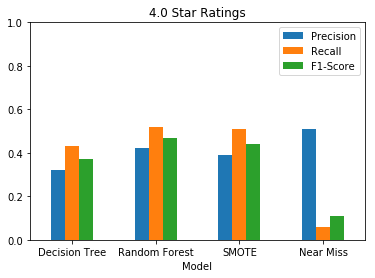

In [60]:
# create 4 star comparison chart
cond = df_results['Rating'] == '4.0 Stars'
df_star = df_results[cond]

# drop columns we don't need
df_star.drop(['Rating', 'Support'], axis=1, inplace=True)

df_star.set_index('Model', inplace=True)


ax = df_star.plot.bar(rot=0, ylim=(0.0,1.0), title ='4.0 Star Ratings')

In [62]:
df_accuracy = pd.DataFrame(list_accuracy)

In [63]:
df_accuracy.set_index('Model', inplace=True)
df_accuracy.head()

,Accuracy
Model,
Decision Tree,0.476611
Random Forest,0.511971
SMOTE,0.428729
Near Miss,0.028729


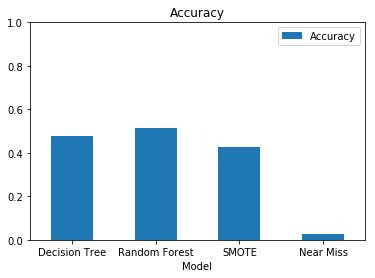

In [66]:
ax = df_accuracy.plot.bar(rot=0, ylim=(0.0,1.0), title ='Accuracy')